In [85]:
import pandas as pd
import numpy as np

# Load your dataset (update path as needed)
df = pd.read_csv(r"C:\Users\pooja\Desktop\Repositories\ad688-employability-sp25A1-pooja\lightcast_job_postings.csv")
df.head()

,ID,LAST_UPDATED_DATE,LAST_UPDATED_TIMESTAMP,DUPLICATES,POSTED,EXPIRED,DURATION,SOURCE_TYPES,SOURCES,URL,...,NAICS_2022_2,NAICS_2022_2_NAME,NAICS_2022_3,NAICS_2022_3_NAME,NAICS_2022_4,NAICS_2022_4_NAME,NAICS_2022_5,NAICS_2022_5_NAME,NAICS_2022_6,NAICS_2022_6_NAME
0,1f57d95acf4dc67ed2819eb12f049f6a5c11782c,2024-09-06,2024-09-06 20:32:57.352 Z,0,2024-06-02,2024-06-08,6.0,"[\n ""Company""\n]","[\n ""brassring.com""\n]","[\n ""https://sjobs.brassring.com/TGnewUI/Sear...",...,44,Retail Trade,441,Motor Vehicle and Parts Dealers,4413,"Automotive Parts, Accessories, and Tire Retailers",44133,Automotive Parts and Accessories Retailers,441330,Automotive Parts and Accessories Retailers
1,0cb072af26757b6c4ea9464472a50a443af681ac,2024-08-02,2024-08-02 17:08:58.838 Z,0,2024-06-02,2024-08-01,NaN,"[\n ""Job Board""\n]","[\n ""maine.gov""\n]","[\n ""https://joblink.maine.gov/jobs/1085740""\n]",...,56,Administrative and Support and Waste Managemen...,561,Administrative and Support Services,5613,Employment Services,56132,Temporary Help Services,561320,Temporary Help Services
2,85318b12b3331fa490d32ad014379df01855c557,2024-09-06,2024-09-06 20:32:57.352 Z,1,2024-06-02,2024-07-07,35.0,"[\n ""Job Board""\n]","[\n ""dejobs.org""\n]","[\n ""https://dejobs.org/dallas-tx/data-analys...",...,52,Finance and Insurance,524,Insurance Carriers and Related Activities,5242,"Agencies, Brokerages, and Other Insurance Rela...",52429,Other Insurance Related Activities,524291,Claims Adjusting
3,1b5c3941e54a1889ef4f8ae55b401a550708a310,2024-09-06,2024-09-06 20:32:57.352 Z,1,2024-06-02,2024-07-20,48.0,"[\n ""Job Board""\n]","[\n ""disabledperson.com"",\n ""dejobs.org""\n]","[\n ""https://www.disabledperson.com/jobs/5948...",...,52,Finance and Insurance,522,Credit Intermediation and Related Activities,5221,Depository Credit Intermediation,52211,Commercial Banking,522110,Commercial Banking
4,cb5ca25f02bdf25c13edfede7931508bfd9e858f,2024-06-19,2024-06-19 07:00:00.000 Z,0,2024-06-02,2024-06-17,15.0,"[\n ""FreeJobBoard""\n]","[\n ""craigslist.org""\n]","[\n ""https://modesto.craigslist.org/sls/77475...",...,99,Unclassified Industry,999,Unclassified Industry,9999,Unclassified Industry,99999,Unclassified Industry,999999,Unclassified Industry


### Exploratory Data Analysis (EDA)

In [86]:
df.columns.tolist()

['ID',
 'LAST_UPDATED_DATE',
 'LAST_UPDATED_TIMESTAMP',
 'DUPLICATES',
 'POSTED',
 'EXPIRED',
 'DURATION',
 'SOURCE_TYPES',
 'SOURCES',
 'URL',
 'ACTIVE_URLS',
 'ACTIVE_SOURCES_INFO',
 'TITLE_RAW',
 'BODY',
 'MODELED_EXPIRED',
 'MODELED_DURATION',
 'COMPANY',
 'COMPANY_NAME',
 'COMPANY_RAW',
 'COMPANY_IS_STAFFING',
 'EDUCATION_LEVELS',
 'EDUCATION_LEVELS_NAME',
 'MIN_EDULEVELS',
 'MIN_EDULEVELS_NAME',
 'MAX_EDULEVELS',
 'MAX_EDULEVELS_NAME',
 'EMPLOYMENT_TYPE',
 'EMPLOYMENT_TYPE_NAME',
 'MIN_YEARS_EXPERIENCE',
 'MAX_YEARS_EXPERIENCE',
 'IS_INTERNSHIP',
 'SALARY',
 'REMOTE_TYPE',
 'REMOTE_TYPE_NAME',
 'ORIGINAL_PAY_PERIOD',
 'SALARY_TO',
 'SALARY_FROM',
 'LOCATION',
 'CITY',
 'CITY_NAME',
 'COUNTY',
 'COUNTY_NAME',
 'MSA',
 'MSA_NAME',
 'STATE',
 'STATE_NAME',
 'COUNTY_OUTGOING',
 'COUNTY_NAME_OUTGOING',
 'COUNTY_INCOMING',
 'COUNTY_NAME_INCOMING',
 'MSA_OUTGOING',
 'MSA_NAME_OUTGOING',
 'MSA_INCOMING',
 'MSA_NAME_INCOMING',
 'NAICS2',
 'NAICS2_NAME',
 'NAICS3',
 'NAICS3_NAME',
 'NAICS4

In [87]:
print(df.shape)

(72476, 131)


In [88]:
print(df.head())

                                         ID LAST_UPDATED_DATE  \
0  1f57d95acf4dc67ed2819eb12f049f6a5c11782c        2024-09-06   
1  0cb072af26757b6c4ea9464472a50a443af681ac        2024-08-02   
2  85318b12b3331fa490d32ad014379df01855c557        2024-09-06   
3  1b5c3941e54a1889ef4f8ae55b401a550708a310        2024-09-06   
4  cb5ca25f02bdf25c13edfede7931508bfd9e858f        2024-06-19   

      LAST_UPDATED_TIMESTAMP  DUPLICATES      POSTED     EXPIRED  DURATION  \
0  2024-09-06 20:32:57.352 Z           0  2024-06-02  2024-06-08       6.0   
1  2024-08-02 17:08:58.838 Z           0  2024-06-02  2024-08-01       NaN   
2  2024-09-06 20:32:57.352 Z           1  2024-06-02  2024-07-07      35.0   
3  2024-09-06 20:32:57.352 Z           1  2024-06-02  2024-07-20      48.0   
4  2024-06-19 07:00:00.000 Z           0  2024-06-02  2024-06-17      15.0   

             SOURCE_TYPES                                        SOURCES  \
0       [\n  "Company"\n]                        [\n  "brassring

In [89]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72476 entries, 0 to 72475
Columns: 131 entries, ID to NAICS_2022_6_NAME
dtypes: bool(2), float64(11), int64(27), object(91)
memory usage: 71.5+ MB
None


In [90]:
df.isnull().sum().to_frame()


,0
ID,0
LAST_UPDATED_DATE,0
LAST_UPDATED_TIMESTAMP,0
DUPLICATES,0
POSTED,0
...,...
NAICS_2022_4_NAME,0
NAICS_2022_5,0
NAICS_2022_5_NAME,0
NAICS_2022_6,0


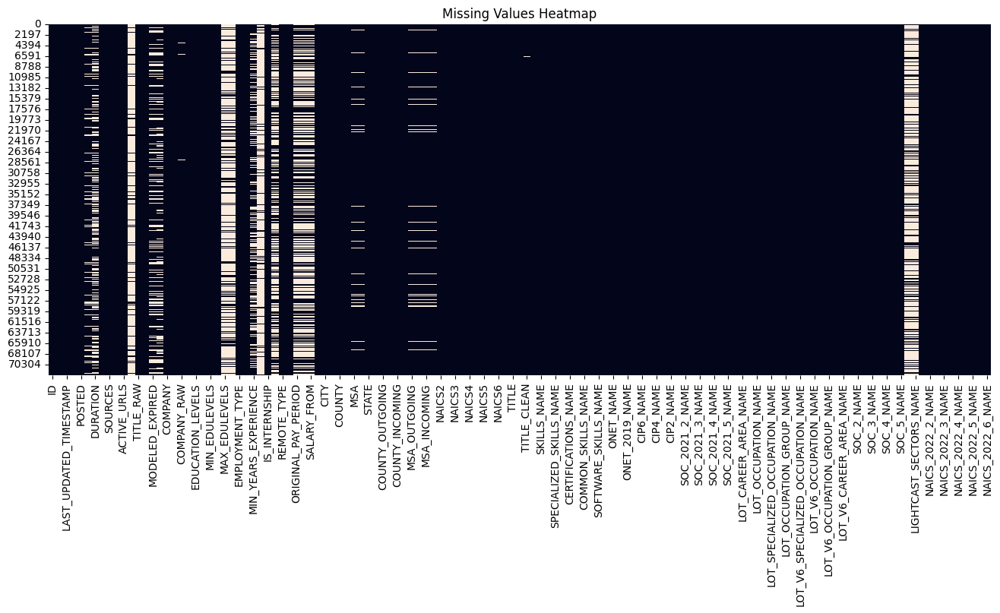

In [91]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(16,6))
sns.heatmap(df.isnull(), cbar=False)
plt.title("Missing Values Heatmap")
plt.show()


In [92]:
missing_counts = df.isnull().sum().sort_values(ascending=False)
print(missing_counts[missing_counts > 0])


ACTIVE_SOURCES_INFO       64654
MAX_YEARS_EXPERIENCE      64046
MAX_EDULEVELS_NAME        56155
MAX_EDULEVELS             56155
LIGHTCAST_SECTORS         54682
LIGHTCAST_SECTORS_NAME    54682
SALARY                    41658
SALARY_FROM               40068
SALARY_TO                 40068
ORIGINAL_PAY_PERIOD       40068
DURATION                  27294
MIN_YEARS_EXPERIENCE      23113
MODELED_DURATION          19261
MODELED_EXPIRED           15383
EXPIRED                    7822
MSA_INCOMING               3921
MSA_NAME_INCOMING          3921
MSA_NAME                   3908
MSA                        3908
MSA_NAME_OUTGOING          3908
MSA_OUTGOING               3908
COMPANY_RAW                 497
TITLE_CLEAN                  96
TITLE_RAW                    60
dtype: int64


In [93]:
thresh = 0.7 * len(df)
df = df.loc[:, df.isnull().sum() < thresh]


In [94]:
threshold = 0.7 * len(df)
df = df.loc[:, df.isnull().sum() < threshold]


In [95]:
df['SALARY'] = df['SALARY'].fillna(df['SALARY'].median())
df['MIN_YEARS_EXPERIENCE'] = df['MIN_YEARS_EXPERIENCE'].fillna(df['MIN_YEARS_EXPERIENCE'].median())
df['DURATION'] = df['DURATION'].fillna(df['DURATION'].median())


In [96]:
df['COMPANY_RAW'] = df['COMPANY_RAW'].fillna('Unknown')
df['TITLE_CLEAN'] = df['TITLE_CLEAN'].fillna('Unknown')
df['TITLE_RAW'] = df['TITLE_RAW'].fillna('Unknown')


In [97]:
df = df.dropna(subset=['SALARY', 'TITLE_CLEAN'])  # Only if these are critical for your analysis


In [98]:
print(df.isnull().sum()[df.isnull().sum() > 0])


EXPIRED                 7822
MODELED_EXPIRED        15383
MODELED_DURATION       19261
ORIGINAL_PAY_PERIOD    40068
SALARY_TO              40068
SALARY_FROM            40068
MSA                     3908
MSA_NAME                3908
MSA_OUTGOING            3908
MSA_NAME_OUTGOING       3908
MSA_INCOMING            3921
MSA_NAME_INCOMING       3921
dtype: int64


In [99]:
df['SALARY_TO'] = df['SALARY_TO'].fillna(df['SALARY_TO'].median())
df['SALARY_FROM'] = df['SALARY_FROM'].fillna(df['SALARY_FROM'].median())
df['ORIGINAL_PAY_PERIOD'] = df['ORIGINAL_PAY_PERIOD'].fillna('Unknown')


In [100]:
df['EXPIRED'] = df['EXPIRED'].fillna('Unknown')
df['MODELED_EXPIRED'] = df['MODELED_EXPIRED'].fillna('Unknown')


In [101]:
df['MSA'] = df['MSA'].fillna('Unknown')
df['MSA_NAME'] = df['MSA_NAME'].fillna('Unknown')
df['MSA_OUTGOING'] = df['MSA_OUTGOING'].fillna('Unknown')
df['MSA_NAME_OUTGOING'] = df['MSA_NAME_OUTGOING'].fillna('Unknown')
df['MSA_INCOMING'] = df['MSA_INCOMING'].fillna('Unknown')
df['MSA_NAME_INCOMING'] = df['MSA_NAME_INCOMING'].fillna('Unknown')


In [102]:
df['MODELED_DURATION'] = df['MODELED_DURATION'].fillna(df['MODELED_DURATION'].median())


In [103]:
print(df.isnull().sum()[df.isnull().sum() > 0])


Series([], dtype: int64)


In [104]:
print(df.shape)
print(df.columns)
print(df.dtypes)
print(df.head())


(72476, 125)
Index(['ID', 'LAST_UPDATED_DATE', 'LAST_UPDATED_TIMESTAMP', 'DUPLICATES',
       'POSTED', 'EXPIRED', 'DURATION', 'SOURCE_TYPES', 'SOURCES', 'URL',
       ...
       'NAICS_2022_2', 'NAICS_2022_2_NAME', 'NAICS_2022_3',
       'NAICS_2022_3_NAME', 'NAICS_2022_4', 'NAICS_2022_4_NAME',
       'NAICS_2022_5', 'NAICS_2022_5_NAME', 'NAICS_2022_6',
       'NAICS_2022_6_NAME'],
      dtype='object', length=125)
ID                        object
LAST_UPDATED_DATE         object
LAST_UPDATED_TIMESTAMP    object
DUPLICATES                 int64
POSTED                    object
                           ...  
NAICS_2022_4_NAME         object
NAICS_2022_5               int64
NAICS_2022_5_NAME         object
NAICS_2022_6               int64
NAICS_2022_6_NAME         object
Length: 125, dtype: object
                                         ID LAST_UPDATED_DATE  \
0  1f57d95acf4dc67ed2819eb12f049f6a5c11782c        2024-09-06   
1  0cb072af26757b6c4ea9464472a50a443af681ac        2024-08-0

In [105]:
print(df.describe(include='all'))


                                              ID LAST_UPDATED_DATE  \
count                                      72476             72476   
unique                                     72476               169   
top     733c12969489de888093ef22d09204dc0945148a        2024-10-09   
freq                                           1             22304   
mean                                         NaN               NaN   
std                                          NaN               NaN   
min                                          NaN               NaN   
25%                                          NaN               NaN   
50%                                          NaN               NaN   
75%                                          NaN               NaN   
max                                          NaN               NaN   

           LAST_UPDATED_TIMESTAMP    DUPLICATES      POSTED  EXPIRED  \
count                       72476  72476.000000       72476    72476   
unique         

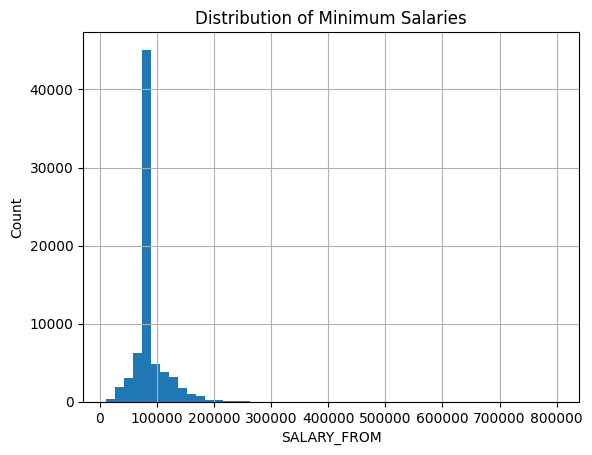

In [106]:
import matplotlib.pyplot as plt
df['SALARY_FROM'].hist(bins=50)
plt.title('Distribution of Minimum Salaries')
plt.xlabel('SALARY_FROM')
plt.ylabel('Count')
plt.show()


In [107]:
print(df['STATE_NAME'].value_counts())
print(df['EMPLOYMENT_TYPE_NAME'].value_counts())


STATE_NAME
Texas                                      8067
California                                 7087
Florida                                    3645
Virginia                                   3636
Illinois                                   3539
New York                                   3341
North Carolina                             2747
Georgia                                    2658
Ohio                                       2627
New Jersey                                 2614
Pennsylvania                               2254
Massachusetts                              2057
Michigan                                   1838
Arizona                                    1638
Washington                                 1626
Minnesota                                  1476
Colorado                                   1455
Maryland                                   1360
Tennessee                                  1274
Missouri                                   1232
Washington, D.C. (District of

In [108]:
print(df.groupby('STATE_NAME')['SALARY_FROM'].mean())
print(df.groupby('EMPLOYMENT_TYPE_NAME')['SALARY_FROM'].mean())


STATE_NAME
Alabama                                    88279.007246
Alaska                                     84794.105932
Arizona                                    87683.371184
Arkansas                                   89840.611301
California                                 95423.065613
Colorado                                   90154.406873
Connecticut                                92808.732329
Delaware                                   90662.648402
Florida                                    89149.689712
Georgia                                    90026.200903
Hawaii                                     90106.038023
Idaho                                      89572.702929
Illinois                                   91415.218988
Indiana                                    88694.947699
Iowa                                       89180.659200
Kansas                                     87888.768919
Kentucky                                   86203.930709
Louisiana                            

In [109]:
df.columns.tolist()

['ID',
 'LAST_UPDATED_DATE',
 'LAST_UPDATED_TIMESTAMP',
 'DUPLICATES',
 'POSTED',
 'EXPIRED',
 'DURATION',
 'SOURCE_TYPES',
 'SOURCES',
 'URL',
 'ACTIVE_URLS',
 'TITLE_RAW',
 'BODY',
 'MODELED_EXPIRED',
 'MODELED_DURATION',
 'COMPANY',
 'COMPANY_NAME',
 'COMPANY_RAW',
 'COMPANY_IS_STAFFING',
 'EDUCATION_LEVELS',
 'EDUCATION_LEVELS_NAME',
 'MIN_EDULEVELS',
 'MIN_EDULEVELS_NAME',
 'EMPLOYMENT_TYPE',
 'EMPLOYMENT_TYPE_NAME',
 'MIN_YEARS_EXPERIENCE',
 'IS_INTERNSHIP',
 'SALARY',
 'REMOTE_TYPE',
 'REMOTE_TYPE_NAME',
 'ORIGINAL_PAY_PERIOD',
 'SALARY_TO',
 'SALARY_FROM',
 'LOCATION',
 'CITY',
 'CITY_NAME',
 'COUNTY',
 'COUNTY_NAME',
 'MSA',
 'MSA_NAME',
 'STATE',
 'STATE_NAME',
 'COUNTY_OUTGOING',
 'COUNTY_NAME_OUTGOING',
 'COUNTY_INCOMING',
 'COUNTY_NAME_INCOMING',
 'MSA_OUTGOING',
 'MSA_NAME_OUTGOING',
 'MSA_INCOMING',
 'MSA_NAME_INCOMING',
 'NAICS2',
 'NAICS2_NAME',
 'NAICS3',
 'NAICS3_NAME',
 'NAICS4',
 'NAICS4_NAME',
 'NAICS5',
 'NAICS5_NAME',
 'NAICS6',
 'NAICS6_NAME',
 'TITLE',
 'TITLE

In [110]:
df.shape

(72476, 125)

#1. Salary Distribution: AI vs. Non-AI Careers (right)

In [111]:
ai_keywords = ['AI', 'Artificial Intelligence', 'Machine Learning', 'Deep Learning', 'Data Scientist', 'NLP', 'Computer Vision']
df['IS_AI_CAREER'] = df['TITLE_CLEAN'].str.contains('|'.join(ai_keywords), case=False, na=False).astype(int)


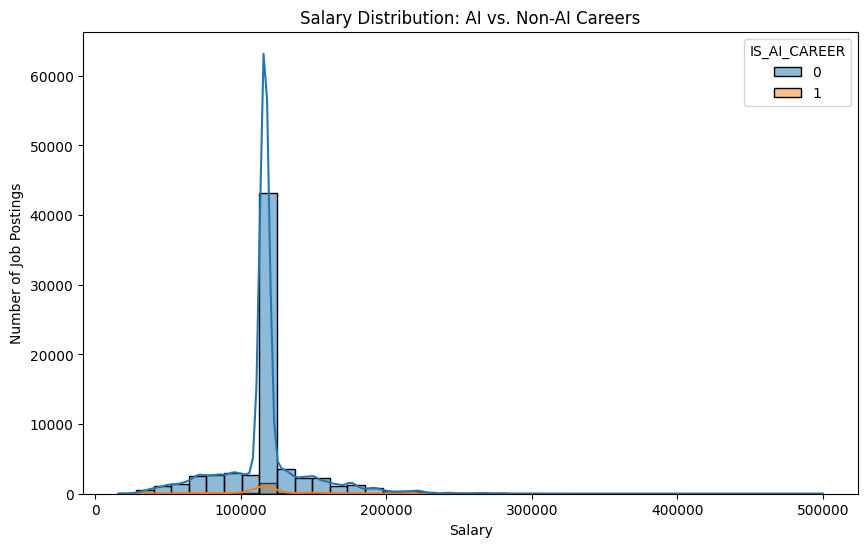

In [112]:
plt.figure(figsize=(10,6))
sns.histplot(data=df, x='SALARY', hue='IS_AI_CAREER', kde=True, bins=40)
plt.title('Salary Distribution: AI vs. Non-AI Careers')
plt.xlabel('Salary')
plt.ylabel('Number of Job Postings')
plt.show()


In [113]:
!pip3 install plotly


[notice] A new release of pip is available: 24.0 -> 25.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [114]:
import plotly.express as px

fig = px.histogram(
    df,
    x='SALARY',
    color='IS_AI_CAREER',  # hue equivalent
    nbins=40,
    marginal='rug',         # optional: shows distribution marks on axis
    opacity=0.7,
    barmode='overlay',      # bars overlap like in Seaborn with hue
    title='Salary Distribution: AI vs. Non-AI Careers',
    labels={'SALARY': 'Salary', 'IS_AI_CAREER': 'AI Career?'}
)

fig.update_layout(
    xaxis_title='Salary',
    yaxis_title='Number of Job Postings',
    bargap=0.05
)

fig.show()

# 2. Boxplot Salary Distribution: AI vs. Non-AI Careers

In [115]:
import plotly.express as px

fig = px.box(
    df,
    x='IS_AI_CAREER',
    y='SALARY',
    color='IS_AI_CAREER',
    title='Salary Distribution: AI vs. Non-AI Careers',
    labels={
        'IS_AI_CAREER': 'AI Career (1 = AI, 0 = Non-AI)',
        'SALARY': 'Salary'
    },
    width=700,
    height=500
)

fig.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=[0, 1],
        ticktext=['Non-AI', 'AI']
    ),
    showlegend=False
)

fig.show()

## Average Salary by Industry (2024)

In [116]:
import plotly.express as px

# Filter and group the data
industry_salary_2024 = (
    df[df['POSTED'].astype(str).str.contains('2024')]  # Ensure POSTED is string
    .groupby('NAICS2_NAME')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(15)
    .reset_index()
)

# Create Plotly bar chart
fig = px.bar(
    industry_salary_2024,
    x='NAICS2_NAME',
    y='SALARY',
    title='Average Salary by Industry (2024)',
    labels={'NAICS2_NAME': 'Industry', 'SALARY': 'Average Salary'},
    height=600
)

fig.update_layout(
    xaxis_tickangle=45
)

fig.show()

## Job Counts by State (AI vs. Non-AI)

In [117]:
import plotly.express as px

# Group and count jobs by state and AI category
region_counts = df.groupby(['STATE_NAME', 'IS_AI_CAREER']).size().reset_index(name='count')

# Create grouped bar chart
fig = px.bar(
    region_counts,
    x='STATE_NAME',
    y='count',
    color='IS_AI_CAREER',
    barmode='group',
    title='Job Counts: AI vs. Non-AI by State',
    labels={
        'STATE_NAME': 'State',
        'count': 'Job Count',
        'IS_AI_CAREER': 'AI Career (1 = AI, 0 = Non-AI)'
    },
    height=600,
    width=1000
)

fig.update_layout(
    xaxis_tickangle=90
)

fig.show()


## Proportion of Remote Jobs in AI vs. Non-AI

In [118]:
import plotly.express as px

# Group by AI status and remote type
remote_counts = df.groupby(['IS_AI_CAREER', 'REMOTE_TYPE_NAME']).size().reset_index(name='count')

# Create interactive grouped bar chart
fig = px.bar(
    remote_counts,
    x='IS_AI_CAREER',
    y='count',
    color='REMOTE_TYPE_NAME',
    barmode='group',
    title='Remote/In-Office Proportion: AI vs. Non-AI Jobs',
    labels={
        'IS_AI_CAREER': 'AI Career (1 = Yes, 0 = No)',
        'count': 'Job Count',
        'REMOTE_TYPE_NAME': 'Remote Type'
    },
    height=500,
    width=800
)

fig.update_layout(xaxis=dict(tickmode='array', tickvals=[0, 1], ticktext=['Non-AI', 'AI']))
fig.show()


### Correlation Matrix 

In [124]:
# Select numeric columns only
df_numeric = df.select_dtypes(include=[np.number])


In [125]:
correlation_matrix = df_numeric.corr()


In [129]:
import plotly.express as px

fig = px.imshow(
    correlation_matrix,
    text_auto=True,
    color_continuous_scale='RdBu_r',
    title='Correlation Matrix (Numeric Features)'
)

fig.update_layout(height=700, width=800)
fig.show()


### Top 10 AI Job Titles by Average Salary

In [119]:
import plotly.express as px

# Prepare data: top 10 AI job titles by average salary
ai_jobs = (
    df[df['IS_AI_CAREER'] == 1]
    .groupby('TITLE_CLEAN')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

# Create bar plot
fig = px.bar(
    ai_jobs,
    x='TITLE_CLEAN',
    y='SALARY',
    title='Top 10 AI Job Titles by Average Salary',
    labels={'TITLE_CLEAN': 'Job Title', 'SALARY': 'Average Salary'},
    height=500
)

fig.update_layout(
    xaxis_tickangle=45
)

fig.show()


### 4. Remote vs. In-Office Salary Comparison

In [120]:
import plotly.express as px

# Filter data to remove missing salary or remote type
df_box = df.dropna(subset=['SALARY', 'REMOTE_TYPE_NAME'])

# Create Plotly boxplot
fig = px.box(
    df_box,
    x='REMOTE_TYPE_NAME',
    y='SALARY',
    title='Salary Distribution: Remote vs. In-Office Jobs',
    labels={'REMOTE_TYPE_NAME': 'Remote Type', 'SALARY': 'Salary'},
    color='REMOTE_TYPE_NAME',  # optional: color by category
    color_discrete_sequence=px.colors.qualitative.Set2,  # nice pastel palette
    height=800
)

fig.update_layout(
    template='plotly_white'
)

fig.show()


### 5. Industry-wise Salary Trends (2024)

In [121]:
import plotly.express as px

# Filter and aggregate industry salary data for 2024
industry_salary_2024 = (
    df[df['POSTED'].astype(str).str.contains('2024')]
    .groupby('NAICS2_NAME')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(15)
    .reset_index()
)

# Create Plotly bar chart
fig = px.bar(
    industry_salary_2024,
    x='NAICS2_NAME',
    y='SALARY',
    title='Average Salary by Industry (2024)',
    labels={'NAICS2_NAME': 'Industry', 'SALARY': 'Average Salary'},
    height=600,
    color_discrete_sequence=['mediumseagreen']
)

# Improve layout
fig.update_layout(
    xaxis_tickangle=45,
    template='plotly_white'
)

fig.show()


### 7. AI vs. Non-AI Job Count by Region

In [122]:
import plotly.express as px

# Step 1: Prepare grouped job count data (already done)
region_counts = df.groupby(['STATE_NAME', 'IS_AI_CAREER']).size().reset_index(name='count')
region_counts['Career Type'] = region_counts['IS_AI_CAREER'].map({0: 'Non-AI', 1: 'AI'})

# Step 2: Create grouped bar chart with Plotly
fig = px.bar(
    region_counts,
    x='STATE_NAME',
    y='count',
    color='Career Type',
    barmode='group',
    title='Job Counts: AI vs. Non-AI by State',
    labels={'STATE_NAME': 'State', 'count': 'Job Count'},
    height=600,
    width=1000,
    color_discrete_map={'AI': 'tomato', 'Non-AI': 'steelblue'}
)

# Step 3: Format the layout
fig.update_layout(
    xaxis_tickangle=60,
    template='plotly_white'
)

fig.show()


# 10. Heatmap: Salary Across States and Years (for AI Careers)

In [123]:
import plotly.express as px

# Create the pivot table (same as in your code)
pivot = df[df['IS_AI_CAREER'] == 1].pivot_table(
    index='STATE_NAME',
    columns='YEAR',
    values='SALARY',
    aggfunc='mean'
).reset_index()

# Melt to long format for Plotly
pivot_melted = pivot.melt(id_vars='STATE_NAME', var_name='YEAR', value_name='Average_Salary')

# Create heatmap
fig = px.density_heatmap(
    pivot_melted,
    x='YEAR',
    y='STATE_NAME',
    z='Average_Salary',
    color_continuous_scale='Viridis',
    title='Heatmap of Average AI Salaries by State and Year',
    labels={'Average_Salary': 'Avg Salary'}
)

fig.update_layout(height=600, width=1000)
fig.show()


KeyError: 'YEAR'

# 11. Boxplot: Salary by Remote Type (AI vs. Non-AI)

In [ ]:
import plotly.express as px

fig = px.box(
    df,
    x='REMOTE_TYPE_NAME',
    y='SALARY',
    color='IS_AI_CAREER',
    title='Salary Distribution by Remote Type (AI vs. Non-AI Careers)',
    labels={
        'REMOTE_TYPE_NAME': 'Remote Type',
        'SALARY': 'Salary',
        'IS_AI_CAREER': 'AI Career (1 = AI, 0 = Non-AI)'
    },
    height=600,
    width=1000
)

fig.update_layout(
    boxmode='group',  # Grouped by hue (IS_AI_CAREER)
    xaxis_tickangle=0
)

fig.show()


# 12. Average Salary by State for AI Jobs

In [ ]:
import plotly.express as px

# Prepare data
avg_salary_state = (
    df[df['IS_AI_CAREER'] == 1]
    .groupby('STATE_NAME')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)

# Create interactive bar chart
fig = px.bar(
    avg_salary_state,
    x='STATE_NAME',
    y='SALARY',
    title='Average AI Career Salary by State',
    labels={'STATE_NAME': 'State', 'SALARY': 'Average Salary'},
    height=600,
    width=1000
)

fig.update_layout(xaxis_tickangle=45)
fig.show()


# 13. Count of AI vs. Non-AI Jobs by State (Top 15 States)

In [ ]:
import plotly.express as px
import pandas as pd

# Group and prepare data
ai_counts = df.groupby(['STATE_NAME', 'IS_AI_CAREER']).size().unstack(fill_value=0)

# Get top 15 states by total job count
top_states = ai_counts.sum(axis=1).sort_values(ascending=False).head(15).index

# Filter and reset for Plotly format
plot_data = ai_counts.loc[top_states].reset_index().melt(id_vars='STATE_NAME', var_name='IS_AI_CAREER', value_name='Job Count')

# Plotly stacked bar chart
fig = px.bar(
    plot_data,
    x='STATE_NAME',
    y='Job Count',
    color='IS_AI_CAREER',
    title='Job Count: AI vs. Non-AI by State (Top 15 States)',
    labels={'STATE_NAME': 'State', 'IS_AI_CAREER': 'Career Type'},
    barmode='stack',
    height=600,
    width=1000
)

fig.update_layout(xaxis_tickangle=45)
fig.show()


# 14. Top 10 Highest-Paying AI Job Titles

In [ ]:
import plotly.express as px

# Prepare data
top_ai_titles = (
    df[df['IS_AI_CAREER'] == 1]
    .groupby('TITLE_CLEAN')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

# Create interactive bar chart
fig = px.bar(
    top_ai_titles,
    x='TITLE_CLEAN',
    y='SALARY',
    title='Top 10 Highest-Paying AI Job Titles',
    labels={'TITLE_CLEAN': 'Job Title', 'SALARY': 'Average Salary'},
    height=800
)

fig.update_layout(xaxis_tickangle=45)
fig.show()


# 15. Salary Distribution by Industry (NAICS2_NAME)

In [ ]:
import plotly.express as px

fig = px.box(
    df,
    x='NAICS2_NAME',
    y='SALARY',
    title='Salary Distribution by Industry',
    labels={'NAICS2_NAME': 'Industry', 'SALARY': 'Salary'},
    height=1500,
    width=1200
)

fig.update_layout(
    xaxis_tickangle=90,
    boxmode='group'
)

fig.show()


# 16. Industry-wise AI vs. Non-AI Job Count

In [ ]:
import plotly.express as px
import pandas as pd

# Group and prepare data
industry_counts = df.groupby(['NAICS2_NAME', 'IS_AI_CAREER']).size().unstack(fill_value=0)

# Get top 10 industries by total job count
top_industries = industry_counts.sum(axis=1).sort_values(ascending=False).head(10).index

# Reshape for Plotly
plot_data = industry_counts.loc[top_industries].reset_index().melt(
    id_vars='NAICS2_NAME',
    var_name='IS_AI_CAREER',
    value_name='Job Count'
)

# Create stacked bar chart
fig = px.bar(
    plot_data,
    x='NAICS2_NAME',
    y='Job Count',
    color='IS_AI_CAREER',
    barmode='stack',
    title='AI vs. Non-AI Job Count by Industry (Top 10)',
    labels={'NAICS2_NAME': 'Industry', 'IS_AI_CAREER': 'Career Type'},
    height=600,
    width=1000
)

fig.update_layout(xaxis_tickangle=45)
fig.show()


# 17. Average Salary by Original Pay Period (AI vs. Non-AI)

In [ ]:
import plotly.express as px

import plotly.io as pio

# Tell Plotly to use Colab's renderer
pio.renderers.default = 'colab'

# Group and calculate average salary
avg_salary = (
    df.groupby(['ORIGINAL_PAY_PERIOD', 'IS_AI_CAREER'])['SALARY']
    .mean()
    .reset_index()
)

# Create interactive grouped bar chart
fig = px.bar(
    avg_salary,
    x='ORIGINAL_PAY_PERIOD',
    y='SALARY',
    color='IS_AI_CAREER',
    barmode='group',
    title='Average Salary by Pay Period (AI vs. Non-AI Careers)',
    labels={
        'ORIGINAL_PAY_PERIOD': 'Pay Period',
        'SALARY': 'Average Salary',
        'IS_AI_CAREER': 'AI Career (1 = AI, 0 = Non-AI)'
    },
    height=500,
    color_discrete_map={
        1: '#007acc',  # AI Career - Professional blue
        0: '#999999'   # Non-AI Career - Neutral gray
    }
)

fig.update_layout(
    xaxis_tickangle=0,
    template='plotly_white',
    legend_title='Career Type'
)

fig.show()


#  visualize the salary trend for AI vs. Non-AI jobs specifically in 2024,

In [ ]:
df['POSTED'] = pd.to_datetime(df['POSTED'], errors='coerce')  # Ensure correct datetime format
df['YEAR'] = df['POSTED'].dt.year
df['MONTH'] = df['POSTED'].dt.month


In [ ]:
df_2024 = df[df['YEAR'] == 2024]


In [ ]:
trend_2024 = df_2024.groupby(['MONTH', 'IS_AI_CAREER'])['SALARY'].mean().reset_index()


In [ ]:
import plotly.express as px

# Create the line plot
fig = px.line(
    trend_2024,
    x='MONTH',
    y='SALARY',
    color='IS_AI_CAREER',
    markers=True,
    title='Monthly Salary Trend in 2024: AI vs. Non-AI Careers',
    labels={
        'MONTH': 'Month',
        'SALARY': 'Average Salary',
        'IS_AI_CAREER': 'AI Career (1 = AI, 0 = Non-AI)'
    }
)

# Customize month ticks
fig.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=list(range(1, 13)),
        ticktext=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']
    ),
    yaxis_title='Average Salary',
    height=500,
    width=900
)

fig.show()


# How do salaries differ across AI vs. non-AI careers

In [ ]:
import plotly.graph_objects as go

# Create violin plots for each group
fig = go.Figure()

fig.add_trace(go.Violin(
    x=df['IS_AI_CAREER'][df['IS_AI_CAREER'] == 0].map({0: 'Non-AI'}),
    y=df['SALARY'][df['IS_AI_CAREER'] == 0],
    name='Non-AI',
    box_visible=True,
    meanline_visible=True
))

fig.add_trace(go.Violin(
    x=df['IS_AI_CAREER'][df['IS_AI_CAREER'] == 1].map({1: 'AI'}),
    y=df['SALARY'][df['IS_AI_CAREER'] == 1],
    name='AI',
    box_visible=True,
    meanline_visible=True
))

# Update layout
fig.update_layout(
    title='Salary Distribution: AI vs. Non-AI Careers',
    xaxis_title='Career Type',
    yaxis_title='Salary',
    height=500,
    width=700
)

fig.show()


In [ ]:
import plotly.express as px

fig = px.histogram(
    df,
    x='SALARY',
    color='IS_AI_CAREER',
    nbins=40,
    barmode='overlay',
    opacity=0.5,
    title='Salary Distribution: AI vs. Non-AI Careers',
    labels={
        'SALARY': 'Salary',
        'IS_AI_CAREER': 'Career Type (0 = Non-AI, 1 = AI)'
    },
    height=500
)

fig.update_layout(
    legend_title_text='Career Type',
    xaxis_title='Salary',
    yaxis_title='Number of Job Postings'
)

fig.show()


In [ ]:
import plotly.express as px
import pandas as pd

# Prepare salary mean and median data
salary_means = df.groupby('IS_AI_CAREER')['SALARY'].mean().reset_index()
salary_means['Metric'] = 'Mean'

salary_medians = df.groupby('IS_AI_CAREER')['SALARY'].median().reset_index()
salary_medians['Metric'] = 'Median'

# Combine for optional side-by-side
salary_combined = pd.concat([salary_means, salary_medians])
salary_combined['Career Type'] = salary_combined['IS_AI_CAREER'].map({0: 'Non-AI', 1: 'AI'})

# Plot Mean Salary
fig_mean = px.bar(
    salary_means,
    x='IS_AI_CAREER',
    y='SALARY',
    color='IS_AI_CAREER',
    title='Average Salary: AI vs. Non-AI Careers',
    labels={'IS_AI_CAREER': 'Career Type', 'SALARY': 'Average Salary'},
    color_discrete_sequence=['skyblue', 'orange'],
    height=400,
    width=500
)
fig_mean.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=[0, 1],
        ticktext=['Non-AI', 'AI']
    ),
    showlegend=False
)
fig_mean.show()

# Plot Median Salary
fig_median = px.bar(
    salary_medians,
    x='IS_AI_CAREER',
    y='SALARY',
    color='IS_AI_CAREER',
    title='Median Salary: AI vs. Non-AI Careers',
    labels={'IS_AI_CAREER': 'Career Type', 'SALARY': 'Median Salary'},
    color_discrete_sequence=['lightgreen', 'salmon'],
    height=400,
    width=500
)
fig_median.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=[0, 1],
        ticktext=['Non-AI', 'AI']
    ),
    showlegend=False
)
fig_median.show()


# What regions offer the highest-paying jobs in AI-related and traditional careers?

### 1. Bar Chart: Top 10 States by Average Salary (AI vs. Non-AI)

In [ ]:
import plotly.express as px

# Step 1: Calculate average salary by state and AI flag
avg_salary = df.groupby(['STATE_NAME', 'IS_AI_CAREER'])['SALARY'].mean().reset_index()

# Step 2: Filter top 10 AI states
top_states_ai = avg_salary[avg_salary['IS_AI_CAREER'] == 1].sort_values('SALARY', ascending=False).head(10)

# Step 3: Plot with annotations
fig_ai = px.bar(
    top_states_ai,
    x='STATE_NAME',
    y='SALARY',
    text='SALARY',  # ➜ Show salary values
    title='Top 10 States by Average AI Job Salary',
    labels={'STATE_NAME': 'State', 'SALARY': 'Average Salary'},
    color_discrete_sequence=['pink'],
    height=500
)

# Format labels
fig_ai.update_traces(
    texttemplate='$%{text:,.0f}',  # format as currency with no decimals
    textposition='outside'
)

# Optional layout tweaks
fig_ai.update_layout(
    uniformtext_minsize=8,
    uniformtext_mode='hide'
)

fig_ai.show()


In [ ]:
import plotly.express as px

# Step 3: Filter top 10 Non-AI states
top_states_nonai = avg_salary[avg_salary['IS_AI_CAREER'] == 0].sort_values('SALARY', ascending=False).head(10)

# Create bar chart with annotations
fig_nonai = px.bar(
    top_states_nonai,
    x='STATE_NAME',
    y='SALARY',
    text='SALARY',  # <== Add this line
    title='Top 10 States by Average Non-AI Job Salary',
    labels={'STATE_NAME': 'State', 'SALARY': 'Average Salary'},
    color_discrete_sequence=['skyblue'],
    height=650
)

# Format annotations
fig_nonai.update_traces(
    texttemplate='$%{text:,.0f}',  # format as currency
    textposition='outside'
)

fig_nonai.update_layout(
    uniformtext_minsize=8,
    uniformtext_mode='hide'
)

fig_nonai.show()


In [ ]:
df.columns.to_list()

['ID',
 'LAST_UPDATED_DATE',
 'LAST_UPDATED_TIMESTAMP',
 'DUPLICATES',
 'POSTED',
 'EXPIRED',
 'DURATION',
 'SOURCE_TYPES',
 'SOURCES',
 'URL',
 'ACTIVE_URLS',
 'TITLE_RAW',
 'BODY',
 'MODELED_EXPIRED',
 'MODELED_DURATION',
 'COMPANY',
 'COMPANY_NAME',
 'COMPANY_RAW',
 'COMPANY_IS_STAFFING',
 'EDUCATION_LEVELS',
 'EDUCATION_LEVELS_NAME',
 'MIN_EDULEVELS',
 'MIN_EDULEVELS_NAME',
 'EMPLOYMENT_TYPE',
 'EMPLOYMENT_TYPE_NAME',
 'MIN_YEARS_EXPERIENCE',
 'IS_INTERNSHIP',
 'SALARY',
 'REMOTE_TYPE',
 'REMOTE_TYPE_NAME',
 'ORIGINAL_PAY_PERIOD',
 'SALARY_TO',
 'SALARY_FROM',
 'LOCATION',
 'CITY',
 'CITY_NAME',
 'COUNTY',
 'COUNTY_NAME',
 'MSA',
 'MSA_NAME',
 'STATE',
 'STATE_NAME',
 'COUNTY_OUTGOING',
 'COUNTY_NAME_OUTGOING',
 'COUNTY_INCOMING',
 'COUNTY_NAME_INCOMING',
 'MSA_OUTGOING',
 'MSA_NAME_OUTGOING',
 'MSA_INCOMING',
 'MSA_NAME_INCOMING',
 'NAICS2',
 'NAICS2_NAME',
 'NAICS3',
 'NAICS3_NAME',
 'NAICS4',
 'NAICS4_NAME',
 'NAICS5',
 'NAICS5_NAME',
 'NAICS6',
 'NAICS6_NAME',
 'TITLE',
 'TITLE

### 2. Side-by-Side Bar Chart: Top States by Salary (AI vs. Non-AI)

In [ ]:
import pandas as pd
import plotly.express as px

# 1. Filter rows with valid salary and AI flag
df_filtered = df.dropna(subset=['SALARY', 'STATE_NAME', 'IS_AI_CAREER'])

# 2. Group and calculate average salary by state and AI category
avg_salary = (
    df_filtered.groupby(['STATE_NAME', 'IS_AI_CAREER'])['SALARY']
    .mean()
    .reset_index()
)

# 3. Pivot table to create separate columns for AI and Non-AI
pivot_salary = avg_salary.pivot(index='STATE_NAME', columns='IS_AI_CAREER', values='SALARY').dropna()

# 4. Select top 10 states based on average of both categories
top_states = pivot_salary.mean(axis=1).sort_values(ascending=False).head(10).index
pivot_salary = pivot_salary.loc[top_states]

# 5. Rename columns for clarity
pivot_salary.columns = ['Non-AI', 'AI']

# 6. Convert to long format for Plotly
plot_data = pivot_salary.reset_index().melt(id_vars='STATE_NAME', var_name='Career Type', value_name='Average Salary')

# 7. Plot with custom colors
fig = px.bar(
    plot_data,
    x='STATE_NAME',
    y='Average Salary',
    color='Career Type',
    barmode='group',
    title='Top States by Average Salary: AI vs. Non-AI Jobs',
    labels={'STATE_NAME': 'State'},
    height=600,
    width=1000,
    color_discrete_map={'AI': 'pink', 'Non-AI': 'skyblue'}
)

fig.update_layout(xaxis_tickangle=45)
fig.show()


# Are remote jobs better paying than in-office roles?

### 1. Boxplot: Salary by Remote Type

In [ ]:
import plotly.express as px

# Create interactive boxplot
fig = px.box(
    df,
    x='REMOTE_TYPE_NAME',
    y='SALARY',
    title='Salary Comparison: Remote vs. In-Office vs. Hybrid Jobs',
    labels={'REMOTE_TYPE_NAME': 'Job Type', 'SALARY': 'Salary'},
    points=False,  # Equivalent to showfliers=False
    height=500,
    width=800
)

fig.show()


### 2. Violin Plot: Salary by Remote Type

In [ ]:
import plotly.graph_objects as go

# Get unique remote job types
remote_types = df['REMOTE_TYPE_NAME'].dropna().unique()

# Create violin traces for each remote type
fig = go.Figure()

for job_type in remote_types:
    fig.add_trace(go.Violin(
        x=[job_type] * len(df[df['REMOTE_TYPE_NAME'] == job_type]),
        y=df[df['REMOTE_TYPE_NAME'] == job_type]['SALARY'],
        name=job_type,
        box_visible=True,
        meanline_visible=True,
        points=False  # Set to 'all' if you want to show individual data points
    ))

# Update layout
fig.update_layout(
    title='Salary Distribution: Remote vs. In-Office vs. Hybrid',
    xaxis_title='Job Type',
    yaxis_title='Salary',
    height=600,
    width=800
)

fig.show()


### 3. Bar Chart: Mean or Median Salary by Remote Type

In [ ]:
import plotly.express as px

# Compute mean salary by job type
mean_salary = df.groupby('REMOTE_TYPE_NAME')['SALARY'].mean().sort_values(ascending=False).reset_index()

# Create bar chart with annotations
fig = px.bar(
    mean_salary,
    x='REMOTE_TYPE_NAME',
    y='SALARY',
    text='SALARY',  # Add value labels
    title='Average Salary by Job Type (Remote vs. In-Office vs. Hybrid)',
    labels={'REMOTE_TYPE_NAME': 'Job Type', 'SALARY': 'Average Salary'},
    color_discrete_sequence=['skyblue'],
    height=500,
    width=700
)

# Format salary annotations
fig.update_traces(texttemplate='$%{text:,.0f}', textposition='outside')

# Adjust layout
fig.update_layout(
    xaxis_tickangle=0,
    uniformtext_minsize=10,
    uniformtext_mode='hide'  # hide labels if they overlap
)

fig.show()


### What industries saw the biggest wage growth in 2024?

### 1. Calculate Wage Growth Percent by Industry

In [ ]:
df['POSTED'] = pd.to_datetime(df['POSTED'], errors='coerce')
df['YEAR'] = df['POSTED'].dt.year

# Group by industry and year, then get mean salary
industry_year = df[df['YEAR'].isin([2023, 2024])].groupby(['NAICS2_NAME', 'YEAR'])['SALARY'].mean().unstack()

# Calculate growth percentage
industry_year['WAGE_GROWTH_%'] = 100 * (industry_year[2024] - industry_year[2024]) / industry_year[2024]
# Remove industries without both years' data
industry_year = industry_year.dropna(subset=[2024, 2024])


In [ ]:
df['POSTED'] = pd.to_datetime(df['POSTED'], errors='coerce')
df['YEAR'] = df['POSTED'].dt.year

# Group by industry and year, then get mean salary
industry_year = (
    df[df['YEAR'].isin([2023, 2024])]
    .groupby(['NAICS2_NAME', 'YEAR'])['SALARY']
    .mean()
    .unstack()
)

# Only keep industries with data for both years
industry_year = industry_year.dropna(subset=[2024, 2024])

# Calculate growth percentage safely
industry_year['WAGE_GROWTH_%'] = 100 * (industry_year[2024] - industry_year[2024]) / industry_year[2024]


In [ ]:
print(industry_year.columns)


Index([2024, 'WAGE_GROWTH_%'], dtype='object', name='YEAR')


In [ ]:
import plotly.express as px

# Compute top 10 industries by average salary for 2024
industry_salary_2024 = (
    df[df['YEAR'] == 2024]
    .groupby('NAICS2_NAME')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

# Create interactive bar chart with annotations
fig = px.bar(
    industry_salary_2024,
    x='NAICS2_NAME',
    y='SALARY',
    text='SALARY',  # This adds labels on top of bars
    title='Top 10 Highest Paying Industries (2024)',
    labels={'NAICS2_NAME': 'Industry', 'SALARY': 'Average Salary'},
    color_discrete_sequence=['pink'],
    height=650,
    width=900
)

# Format text labels (e.g., $120,000)
fig.update_traces(texttemplate='$%{text:,.0f}', textposition='outside')

fig.update_layout(
    xaxis_tickangle=45,
    uniformtext_minsize=10,
    uniformtext_mode='hide'  # hides overlapping labels
)

fig.show()


In [ ]:
import plotly.express as px

industry_salary_2024 = (
    df[df['YEAR'] == 2024]
    .groupby('NAICS2_NAME')['SALARY']
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

fig = px.bar(
    industry_salary_2024,
    x='NAICS2_NAME',
    y='SALARY',
    title='Top 10 Highest Paying Industries (2024)',
    labels={'NAICS2_NAME': 'Industry', 'SALARY': 'Average Salary'},
    color='SALARY',
    color_continuous_scale='Greens'
)

fig.update_layout(
    xaxis_tickangle=45,
    template='plotly_white'
)

fig.show()


## Plotly Pie Chart (Interactive)

In [ ]:
import plotly.express as px

# Prepare data
ai_counts = df['IS_AI_CAREER'].value_counts().reset_index()
ai_counts.columns = ['IS_AI_CAREER', 'Count']
ai_counts['Category'] = ai_counts['IS_AI_CAREER'].map({0: 'Non-AI', 1: 'AI'})

# Plot
fig = px.pie(
    ai_counts,
    values='Count',
    names='Category',
    title='AI vs. Non-AI Job Distribution',
    color_discrete_sequence=['skyblue', 'orange']
)

fig.update_traces(textinfo='percent+label')
fig.show()


In [ ]:
import plotly.express as px

# Optional: remove rows with missing salary values
scatter_df = df.dropna(subset=['SALARY_FROM', 'SALARY_TO', 'IS_AI_CAREER'])

# Optional: limit outliers for clearer visualization
scatter_df = scatter_df[(scatter_df['SALARY_FROM'] < 200000) & (scatter_df['SALARY_TO'] < 250000)]

# Plot
fig = px.scatter(
    scatter_df,
    x='SALARY_FROM',
    y='SALARY_TO',
    color='IS_AI_CAREER',
    labels={'IS_AI_CAREER': 'AI Job'},
    title='Scatter Plot: Salary From vs. Salary To (AI vs. Non-AI)',
    hover_data=['TITLE_CLEAN', 'STATE_NAME'],
    color_discrete_map={0: 'skyblue', 1: 'orange'}
)

fig.update_layout(template='plotly_white')
fig.show()


In [ ]:
fig = px.scatter(
    df[df['YEAR'] == 2024],
    x='POSTED',
    y='SALARY',
    color='IS_AI_CAREER',
    title='AI vs. Non-AI Salaries Over Time (2024)',
    labels={'IS_AI_CAREER': 'AI Job'},
    hover_data=['TITLE_CLEAN', 'STATE_NAME']
)
fig.update_layout(template='plotly_white')
fig.show()


In [ ]:
# Regenerate the DataFrame correctly
df['POSTED'] = pd.to_datetime(df['POSTED'], errors='coerce')

daily_avg_salary = (
    df[df['POSTED'].dt.year == 2024]
    .groupby([df['POSTED'].dt.date, 'IS_AI_CAREER'])['SALARY']
    .mean()
    .reset_index()
)

daily_avg_salary.columns = ['Date', 'AI Job', 'Avg Salary']


In [ ]:
import plotly.express as px

fig = px.line(
    daily_avg_salary,
    x='Date',
    y='Avg Salary',
    color='AI Job',
    color_discrete_map={0: 'blue', 1: 'orange'},
    labels={'AI Job': 'Career Type'},
    title='📈 Daily Average Salary Trend (AI vs Non-AI Jobs) - 2024'
)

fig.update_layout(
    xaxis_title='Date Posted',
    yaxis_title='Average Salary',
    legend_title='Job Type',
    template='plotly_white'
)
fig.show()


## 1. Multiple Linear Regression

In [132]:
%pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [133]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
import numpy as np

# Prepare data
features = ['STATE_NAME', 'TITLE_CLEAN', 'SKILLS_NAME']
target = 'SALARY'

df_reg = df.dropna(subset=features + [target])
X = df_reg[features]
y = df_reg[target]

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# One-hot encode categorical features
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), features)
])

# Create regression model
reg_model = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', LinearRegression())
])

# Fit and evaluate
reg_model.fit(X_train, y_train)
print("Train R²:", reg_model.score(X_train, y_train))
print("Test R²:", reg_model.score(X_test, y_test))


Train R²: 0.9808207991321921
Test R²: 0.5143198085664493


In [ ]:
# 1. Import required libraries
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
import pandas as pd
import numpy as np

# 2. Load your dataset (replace this with your actual data)
# Example: df = pd.read_csv("lightcast_job_postings.csv")

# 3. Select features and target
features = ['STATE_NAME', 'TITLE_CLEAN', 'SKILLS_NAME']
target = 'SALARY'

# 4. Drop missing values in required columns
df_reg = df.dropna(subset=features + [target])

# 5. Define X and y
X = df_reg[features]
y = df_reg[target]

# 6. Train-test split (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# 7. Preprocessor: one-hot encode categorical features
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), features)
])

# 8. Build pipeline with preprocessing + Linear Regression
reg_model = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', LinearRegression())
])

# 9. Fit the model
reg_model.fit(X_train, y_train)

# 10. Evaluate
train_score = reg_model.score(X_train, y_train)
test_score = reg_model.score(X_test, y_test)

print(f" Train R²: {train_score:.4f}")
print(f" Test R²: {test_score:.4f}")


 Train R²: 0.9808
 Test R²: 0.5143


In [ ]:
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

# Predict salary on test data
y_pred = reg_model.predict(X_test)

# R² Score
r2 = r2_score(y_test, y_pred)

# RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"✅ R² Score: {r2:.4f}")
print(f"📉 RMSE: ${rmse:,.2f}")


✅ R² Score: 0.5143
📉 RMSE: $20,424.01


In [ ]:
# Keep top 50 titles
top_titles = df_reg['TITLE_CLEAN'].value_counts().nlargest(50).index
df_reg['TITLE_CLEAN'] = df_reg['TITLE_CLEAN'].where(df_reg['TITLE_CLEAN'].isin(top_titles), 'Other')

# Keep top 50 skills
top_skills = df_reg['SKILLS_NAME'].value_counts().nlargest(50).index
df_reg['SKILLS_NAME'] = df_reg['SKILLS_NAME'].where(df_reg['SKILLS_NAME'].isin(top_skills), 'Other')


In [130]:
import plotly.express as px
import pandas as pd

# Get predictions
y_pred = reg_model.predict(X_test)

# Create a DataFrame to plot
results_df = pd.DataFrame({
    'Actual Salary': y_test,
    'Predicted Salary': y_pred
})

# Plot using Plotly
fig = px.scatter(
    results_df,
    x='Actual Salary',
    y='Predicted Salary',
    title='Predicted vs Actual Salary (Plotly)',
    labels={'x': 'Actual Salary', 'y': 'Predicted Salary'},
    opacity=0.6
)

# Add reference line (y = x)
fig.add_shape(
    type='line',
    x0=results_df['Actual Salary'].min(),
    y0=results_df['Actual Salary'].min(),
    x1=results_df['Actual Salary'].max(),
    y1=results_df['Actual Salary'].max(),
    line=dict(color='red', dash='dash'),
)

fig.update_layout(template='plotly_white')
fig.show()


## Ridge Regression

In [ ]:
from sklearn.linear_model import Ridge

reg_model = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', Ridge(alpha=1.0))
])
reg_model.fit(X_train, y_train)
print("Train R²:", reg_model.score(X_train, y_train))
print("Test R²:", reg_model.score(X_test, y_test))


Train R²: 0.9077647413163654
Test R²: 0.5418680264560262


In [131]:
import plotly.express as px
import pandas as pd

# Predict using your trained model
y_pred = reg_model.predict(X_test)

# Create DataFrame for plotting
results_df = pd.DataFrame({
    'Actual Salary': y_test,
    'Predicted Salary': y_pred
})

# Create scatter plot
fig = px.scatter(
    results_df,
    x='Actual Salary',
    y='Predicted Salary',
    title='Ridge Regression: Predicted vs Actual Salary',
    opacity=0.6,
    template='plotly_white'
)

# Add reference diagonal (perfect predictions)
fig.add_shape(
    type='line',
    x0=results_df['Actual Salary'].min(),
    y0=results_df['Actual Salary'].min(),
    x1=results_df['Actual Salary'].max(),
    y1=results_df['Actual Salary'].max(),
    line=dict(color='red', dash='dash'),
)

fig.update_layout(
    xaxis_title='Actual Salary',
    yaxis_title='Predicted Salary'
)

fig.show()


## Ridge Regression


In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
import numpy as np
import pandas as pd

# Define your features
features = ['STATE_NAME', 'TITLE_CLEAN', 'SKILLS_NAME', 'MIN_YEARS_EXPERIENCE', 'DURATION']
target = 'SALARY'

# Drop missing rows
df_ridge = df.dropna(subset=features + [target]).copy()

# Optional: reduce cardinality
top_titles = df_ridge['TITLE_CLEAN'].value_counts().nlargest(50).index
df_ridge['TITLE_CLEAN'] = df_ridge['TITLE_CLEAN'].where(df_ridge['TITLE_CLEAN'].isin(top_titles), 'Other')

top_skills = df_ridge['SKILLS_NAME'].value_counts().nlargest(50).index
df_ridge['SKILLS_NAME'] = df_ridge['SKILLS_NAME'].where(df_ridge['SKILLS_NAME'].isin(top_skills), 'Other')

# Fill missing numeric values
df_ridge['MIN_YEARS_EXPERIENCE'] = df_ridge['MIN_YEARS_EXPERIENCE'].fillna(0)
df_ridge['DURATION'] = df_ridge['DURATION'].fillna(0)

# Split features/target
X = df_ridge[features]
y = df_ridge[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:
categorical = ['STATE_NAME', 'TITLE_CLEAN', 'SKILLS_NAME']
numerical = ['MIN_YEARS_EXPERIENCE', 'DURATION']

preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical),
    ('num', 'passthrough', numerical)
])


In [ ]:
from sklearn.linear_model import Ridge

reg_model = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', Ridge(alpha=1.0))  # alpha=1.0 is default
])

reg_model.fit(X_train, y_train)

print("✅ Ridge Train R²:", reg_model.score(X_train, y_train))
print("✅ Ridge Test R²:", reg_model.score(X_test, y_test))


✅ Ridge Train R²: 0.2029771373528101
✅ Ridge Test R²: 0.20619131337105112


In [ ]:
from sklearn.model_selection import GridSearchCV

ridge_pipeline = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', Ridge())
])

params = {
    'regressor__alpha': [0.01, 0.1, 1.0, 10, 100]
}

grid = GridSearchCV(ridge_pipeline, param_grid=params, cv=5, scoring='r2')
grid.fit(X_train, y_train)

print("Best alpha:", grid.best_params_)
print("Best CV R²:", grid.best_score_)

# Evaluate best model on test set
print("Test R² with best alpha:", grid.score(X_test, y_test))


Best alpha: {'regressor__alpha': 0.1}
Best CV R²: 0.20033372156620524
Test R² with best alpha: 0.20611775067826887


In [ ]:
import plotly.express as px
import pandas as pd

# Predict on test set
y_pred = grid.predict(X_test)

# Create DataFrame for plotting
results_df = pd.DataFrame({
    'Actual Salary': y_test,
    'Predicted Salary': y_pred
})

# Plot
fig = px.scatter(
    results_df,
    x='Actual Salary',
    y='Predicted Salary',
    title='Ridge Regression: Predicted vs Actual Salary',
    opacity=0.6
)
fig.add_shape(
    type='line',
    x0=results_df['Actual Salary'].min(),
    y0=results_df['Actual Salary'].min(),
    x1=results_df['Actual Salary'].max(),
    y1=results_df['Actual Salary'].max(),
    line=dict(color='red', dash='dash')
)
fig.update_layout(template='plotly_white')
fig.show()


## Random Forest

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split

# Reuse the same features and cleaned data
features = ['STATE_NAME', 'TITLE_CLEAN', 'SKILLS_NAME']
target = 'SALARY'

df_rf = df.dropna(subset=features + [target]).copy()

# Optionally reduce cardinality (if not already done)
top_titles = df_rf['TITLE_CLEAN'].value_counts().nlargest(50).index
df_rf['TITLE_CLEAN'] = df_rf['TITLE_CLEAN'].where(df_rf['TITLE_CLEAN'].isin(top_titles), 'Other')

top_skills = df_rf['SKILLS_NAME'].value_counts().nlargest(50).index
df_rf['SKILLS_NAME'] = df_rf['SKILLS_NAME'].where(df_rf['SKILLS_NAME'].isin(top_skills), 'Other')

X = df_rf[features]
y = df_rf[target]

# Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocess
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), features)
])

# Random Forest pipeline
rf_model = Pipeline([
    ('preprocess', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Train
rf_model.fit(X_train, y_train)

# Evaluate
train_score = rf_model.score(X_train, y_train)
test_score = rf_model.score(X_test, y_test)

print(f"Random Forest Train R²: {train_score:.4f}")
print(f"Random Forest Test R²: {test_score:.4f}")


Random Forest Train R²: 0.1516
Random Forest Test R²: 0.1260


In [ ]:
import plotly.express as px
import pandas as pd

y_pred = rf_model.predict(X_test)
results_df = pd.DataFrame({'Actual Salary': y_test, 'Predicted Salary': y_pred})

fig = px.scatter(
    results_df,
    x='Actual Salary',
    y='Predicted Salary',
    title='Random Forest: Predicted vs Actual Salary',
    opacity=0.6
)
fig.add_shape(
    type='line',
    x0=results_df['Actual Salary'].min(),
    y0=results_df['Actual Salary'].min(),
    x1=results_df['Actual Salary'].max(),
    y1=results_df['Actual Salary'].max(),
    line=dict(color='red', dash='dash')
)
fig.update_layout(template='plotly_white')
fig.show()


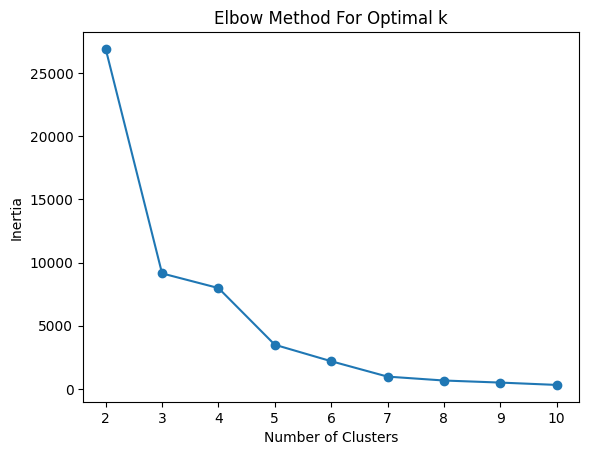

Cluster
0    49246
1    12019
2    11211
dtype: int64


In [ ]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Prepare features for clustering (use code numbers, not names)
features = ['SOC_2021_2', 'NAICS2']  # Change as needed
df_cluster = df.dropna(subset=features).copy()

# Convert categorical codes to numbers (if needed)
for col in features:
    df_cluster[col] = LabelEncoder().fit_transform(df_cluster[col].astype(str))

X = df_cluster[features]
X_scaled = StandardScaler().fit_transform(X)

# Find the optimal number of clusters (Elbow Method)
inertia = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

plt.plot(range(2, 11), inertia, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method For Optimal k')
plt.show()

# Let's use 3 clusters (or your elbow result)
kmeans = KMeans(n_clusters=3, random_state=42)
df_cluster['Cluster'] = kmeans.fit_predict(X_scaled)

print(df_cluster.groupby('Cluster').size())


In [ ]:
import plotly.express as px
import pandas as pd

# Prepare elbow data
elbow_df = pd.DataFrame({
    'k': list(range(2, 11)),
    'inertia': inertia
})

# Create line plot
fig = px.line(
    elbow_df,
    x='k',
    y='inertia',
    markers=True,
    title='Elbow Method for Optimal k',
    labels={'k': 'Number of Clusters', 'inertia': 'Inertia'}
)

fig.show()


In [ ]:
df_with_titles = df.merge(df_cluster[['ID', 'Cluster']], on='ID')


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# For each cluster, analyze keywords in job titles
for cluster_num in sorted(df_with_titles['Cluster'].unique()):
    cluster_data = df_with_titles[df_with_titles['Cluster'] == cluster_num]

    vectorizer = TfidfVectorizer(stop_words='english', max_features=20)
    tfidf_matrix = vectorizer.fit_transform(cluster_data['TITLE_CLEAN'].astype(str))

    print(f"\n🔹 Top Terms in Cluster {cluster_num}:")
    print(vectorizer.get_feature_names_out())



🔹 Top Terms in Cluster 0:
['analyst' 'analytics' 'architect' 'associate' 'business' 'cloud'
 'consultant' 'data' 'enterprise' 'functional' 'intelligence' 'lead'
 'management' 'manager' 'oracle' 'remote' 'sap' 'senior' 'specialist' 'sr']

🔹 Top Terms in Cluster 1:
['analyst' 'analytics' 'architect' 'business' 'career' 'cloud'
 'consultant' 'data' 'enterprise' 'erp' 'functional' 'ii' 'intelligence'
 'lead' 'oracle' 'path' 'remote' 'sap' 'senior' 'sr']

🔹 Top Terms in Cluster 2:
['analyst' 'analytics' 'architect' 'business' 'consultant' 'data'
 'engineer' 'enterprise' 'erp' 'functional' 'ii' 'intelligence' 'lead'
 'management' 'remote' 'sap' 'senior' 'solution' 'sr' 'systems']


In [ ]:
pip install wordcloud


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.



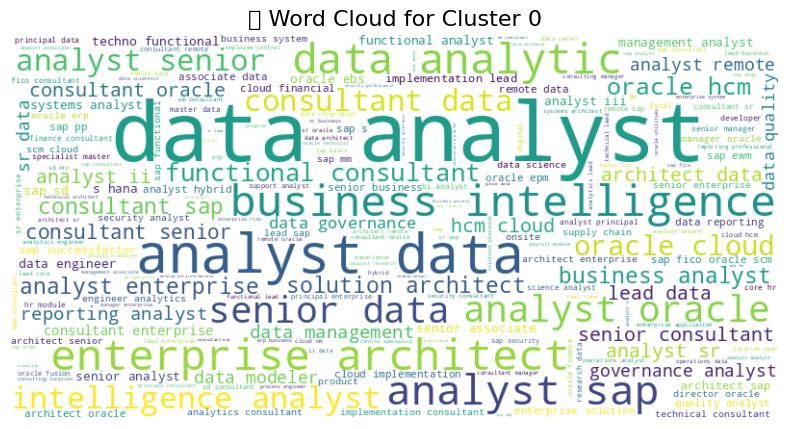

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.



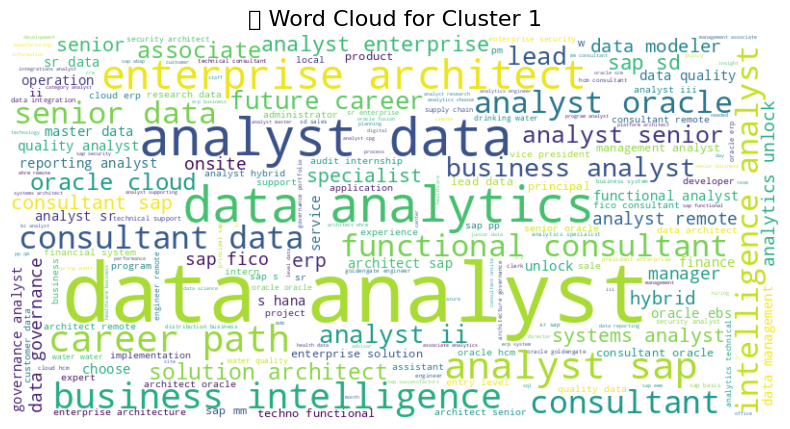

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.



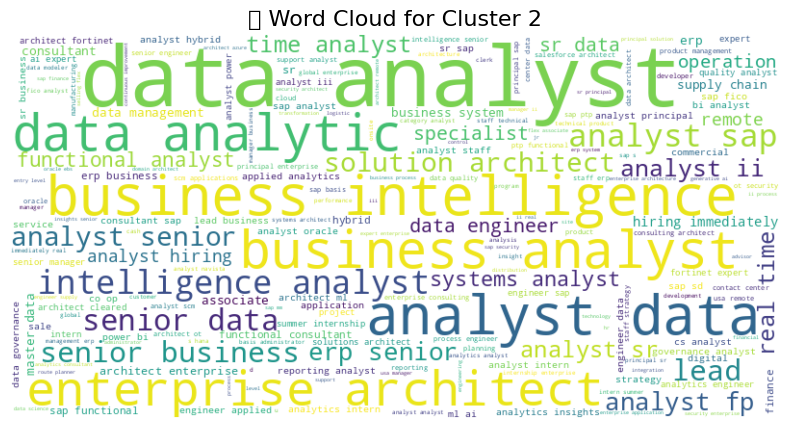

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Combine titles for each cluster into one string
for cluster_num in sorted(df_with_titles['Cluster'].unique()):
    text = ' '.join(df_with_titles[df_with_titles['Cluster'] == cluster_num]['TITLE_CLEAN'].dropna().astype(str))

    # Create word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate(text)

    # Plot
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'🧠 Word Cloud for Cluster {cluster_num}', fontsize=16)
    plt.show()
